In [2]:
# Biến chung sử dụng xuyên suốt
import os
import datetime
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.preprocessing import MinMaxScaler
import sys
sys.path.append('P:/7. User/Tuong')
from DB_ALL import SQL_NLTT_NOIBO, Database_TTD

# Cấu hình chung
PATH = r"Z:\Sky-image\Data"  # Đường dẫn ảnh gốc
OUTPUT_DIR = r"C:\Khue\H9_Solar_Power_Forecasting\data\processed\image_test"  # Thư mục lưu ảnh đã xử lý
START_DATE = datetime.datetime(2024, 6, 1)
END_DATE = datetime.datetime(2025, 3, 21)
PLOT_START = datetime.datetime(2025, 3, 15)
PLOT_END = datetime.datetime(2025, 3, 20)
IMG_SIZE_PROCESS = (256, 256)  # Kích thước ảnh khi xử lý ban đầu
IMG_SIZE_MODEL = (32, 32)  # Kích thước ảnh đầu vào mô hình
SEQ_LENGTH = 6  # Độ dài chuỗi đầu vào
PRED_LENGTH = 6  # Độ dài dự đoán
CHANNELS = ['b07_', 'b13_', 'b08_', 'b03_']
CHANNELS = ['b07_', 'b13_', 'b08_', 'b03_', 'arm', 'cve', 'dms', 'dnc', 'dsl', 'dst', 'irv', 'ngt', 'snd', 'tre', 'trm', 'vir']
# CHANNELS = ['arm', 'cve', 'dms', 'dnc', 'dsl', 'dst', 'irv', 'ngt', 'snd', 'tre', 'trm', 'vir']
NUM_CHANNELS = len(CHANNELS)
BATCH_SIZE = 64
TIME_STEP = datetime.timedelta(minutes=10)
UTC_OFFSET = datetime.timedelta(hours=7)

# Khởi tạo scaler toàn cục
scaler = MinMaxScaler()

In [3]:
# %% Cell 2: Xử lý dữ liệu công suất
def query_power_data(start_date, end_date):
    print("🔄 Đang load dữ liệu công suất...")
    db = SQL_NLTT_NOIBO()
    start_date_str = start_date.strftime('%Y-%m-%d')
    end_date_str = end_date.strftime('%Y-%m-%d')
    df = pd.DataFrame.from_records(db.query(f"""
    SELECT NGAY, ID_CHUKY, SUM(P_VALUE) as P 
    FROM NLTT_REALTIME_LOAIHINH_HIS nrnh 
    WHERE NGAY >= '{start_date_str}' AND NGAY <= '{end_date_str}' AND ID_LOAIHINH = 9
    GROUP BY NGAY, ID_CHUKY 
    ORDER BY NGAY, ID_CHUKY
    """), columns=['NGAY', 'ID_CHUKY', 'P'])

    df["NGAY"] = pd.to_datetime(df["NGAY"])
    df["TIME"] = df["NGAY"] + pd.to_timedelta((df["ID_CHUKY"] - 1) * 5, unit='m')
    df = df[["TIME", "P"]]
    df.rename(columns={"TIME": "Time", "P": "P_uoc"}, inplace=True)
    df = df.set_index("Time").resample('10T').mean()
    power_df = df.reset_index()
    power_df['Time'] = pd.to_datetime(power_df['Time'])
    
    # Fit scaler với dữ liệu P_uoc gốc
    scaler.fit(power_df[['P_uoc']].dropna())  # Dropna để tránh NaN gây lỗi
    power_lookup = power_df.set_index('Time')['P_uoc'].to_dict()
    
    print(f"✅ Đã load {len(power_df)} bản ghi")
    print("Dữ liệu mẫu:", power_df.head())
    print("Lookup mẫu:", {k: power_lookup[k] for k in list(power_lookup.keys())[:5]})
    return power_df, power_lookup, scaler

# Truy vấn dữ liệu toàn cục
power_df, power_lookup, scaler = query_power_data(START_DATE - TIME_STEP * SEQ_LENGTH, END_DATE + TIME_STEP * PRED_LENGTH)

🔄 Đang load dữ liệu công suất...
✅ Đã load 42480 bản ghi
Dữ liệu mẫu:                  Time  P_uoc
0 2024-05-31 00:00:00    0.0
1 2024-05-31 00:10:00    0.0
2 2024-05-31 00:20:00    0.0
3 2024-05-31 00:30:00    0.0
4 2024-05-31 00:40:00    0.0
Lookup mẫu: {Timestamp('2024-05-31 00:00:00'): 0.0, Timestamp('2024-05-31 00:10:00'): 0.0, Timestamp('2024-05-31 00:20:00'): 0.0, Timestamp('2024-05-31 00:30:00'): 0.0, Timestamp('2024-05-31 00:40:00'): 0.0}


In [4]:
# %% Cell 3: Load và xử lý ảnh
def load_and_process_image(path, save_path=None, default_img=None):
    """Xử lý ảnh và lưu, trả về mảng ảnh. Nếu lỗi, dùng ảnh mặc định và vẫn lưu."""
    try:
        with Image.open(path) as img:
            a = 3
            shift_left = 30
            shift_up = 3
            cropped_img = img.crop((462 + a - shift_left, 217 + a - shift_up, 686 - a - shift_left, 441 - a - shift_up))
            cropped_img = cropped_img.resize(IMG_SIZE_PROCESS).convert('L')
            img_array = np.array(cropped_img, dtype=np.float32)
            img_array = (img_array / 127.5) - 1.0
            if save_path:
                cropped_img.save(save_path)
            return img_array
    except (FileNotFoundError, IOError, SyntaxError) as e:
        print(f"Error processing {path}: {e}")
        if save_path and default_img is not None:
            Image.fromarray(((default_img + 1.0) * 127.5).astype(np.uint8)).save(save_path)
        return default_img if default_img is not None else np.zeros(IMG_SIZE_PROCESS, dtype=np.float32)

def process_and_save_images(output_folder, start_date, end_date, channels=CHANNELS, time_step=TIME_STEP):
    print(f"\n🔄 Đang load và xử lý ảnh từ {PATH} để lưu vào {output_folder}...")
    os.makedirs(output_folder, exist_ok=True)
    
    # Tạo chuỗi thời gian liên tiếp với bước 10 phút
    time_series = pd.date_range(start=start_date, end=end_date, freq='10min')
    date_dirs = sorted(set([d.strftime("%Y%m%d") for d in time_series]))
    
    # Khởi tạo dictionary để lưu ảnh gần nhất hợp lệ của từng kênh
    last_images = {ch: np.zeros(IMG_SIZE_PROCESS, dtype=np.float32) for ch in channels}  # Mặc định là zeros
    processed_count = 0  # Đếm ảnh xử lý từ file gốc
    saved_count = 0      # Đếm tổng số ảnh lưu
    
    # Duyệt qua từng folder
    for date_dir in date_dirs:
        print(f"📂 Đang xử lý folder: {date_dir}")
        date_path = os.path.join(PATH, date_dir)
        
        # Lấy các thời điểm trong ngày này
        day_times = [t for t in time_series if t.strftime("%Y%m%d") == date_dir]
        
        if os.path.exists(date_path):
            # Tạo dictionary chứa ảnh gốc tại các thời điểm trong folder
            available_images = {}
            for time_dir in os.listdir(date_path):
                time_path = os.path.join(date_path, time_dir)
                if os.path.isdir(time_path):
                    try:
                        dt = datetime.datetime.strptime(f"{date_dir}T{time_dir}", "%Y%m%dT%H%M")
                        if dt in day_times:
                            available_images[dt] = {}
                            for file in os.listdir(time_path):
                                for ch in channels:
                                    if file.lower().startswith(ch) and file.lower().endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp')):
                                        available_images[dt][ch] = os.path.join(time_path, file)
                    except ValueError:
                        continue
        
        # Lưu ảnh cho từng thời điểm trong ngày
        for dt in day_times:
            for ch in channels:
                output_filename = f"{ch}{dt.strftime('%Y%m%d_%H%M')}.jpg"
                output_path = os.path.join(output_folder, output_filename)
                
                if os.path.exists(date_path) and dt in available_images and ch in available_images[dt]:
                    # Có ảnh gốc, xử lý và lưu
                    img_path = available_images[dt][ch]
                    img_array = load_and_process_image(img_path, save_path=output_path, default_img=last_images[ch])
                    if not np.array_equal(img_array, last_images[ch]):  # Chỉ tăng processed_count nếu ảnh mới
                        processed_count += 1
                    last_images[ch] = img_array  # Cập nhật ảnh gần nhất
                else:
                    # Thiếu ảnh hoặc folder không tồn tại, dùng ảnh gần nhất và lưu
                    print(f"⚠️ Thiếu hoặc lỗi ảnh cho kênh {ch} tại {dt.strftime('%Y-%m-%d %H:%M')}, dùng ảnh gần nhất.")
                    Image.fromarray(((last_images[ch] + 1.0) * 127.5).astype(np.uint8)).save(output_path)
                
                saved_count += 1
    
    print(f"✅ Đã xử lý {processed_count} ảnh từ file gốc và lưu tổng cộng {saved_count} ảnh vào {output_folder}")

# Chạy xử lý ảnh
process_and_save_images(OUTPUT_DIR, START_DATE, END_DATE)


🔄 Đang load và xử lý ảnh từ Z:\Sky-image\Data để lưu vào C:\Khue\H9_Solar_Power_Forecasting\data\processed\image_test...
📂 Đang xử lý folder: 20240601
⚠️ Thiếu hoặc lỗi ảnh cho kênh b07_ tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh b13_ tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh b08_ tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh b03_ tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh arm tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh cve tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh dms tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh dnc tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh dsl tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh dst tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu hoặc lỗi ảnh cho kênh irv tại 2024-06-01 02:50, dùng ảnh gần nhất.
⚠️ Thiếu

KeyboardInterrupt: 

In [3]:
# %% Cell 4: Load ảnh từ output_folder và tạo chuỗi
def load_processed_image(path):
    try:
        with Image.open(path) as img:
            img = img.resize(IMG_SIZE_MODEL)
            img_array = np.array(img, dtype=np.float32)
            img_array = (img_array / 127.5) - 1.0
            return img_array
    except (FileNotFoundError, IOError, SyntaxError) as e:
        print(f"Error loading {path}: {e}")
        return np.zeros(IMG_SIZE_MODEL, dtype=np.float32)

def preprocess_images_from_folder(output_folder, start_date, end_date, channels=CHANNELS):
    print(f"\n🔄 Đang load ảnh từ {output_folder} và tạo chuỗi dữ liệu...")
    image_records = {ch: {} for ch in channels}
    
    for file in os.listdir(output_folder):
        for ch in channels:
            if file.lower().startswith(ch) and file.lower().endswith(('.jpg', '.jpeg', '.png')):
                try:
                    time_str = file[len(ch):-4]
                    dt = datetime.datetime.strptime(time_str, '%Y%m%d_%H%M')
                    if start_date <= dt <= end_date:
                        image_records[ch][dt] = os.path.join(output_folder, file)
                except ValueError as e:
                    print(f"⚠️ File {file} không khớp định dạng thời gian ({e}), bỏ qua.")

    all_times = sorted(set.union(*(set(rec.keys()) for rec in image_records.values())))
    print(f"📊 Tìm thấy {len(all_times)} thời điểm từ {start_date.strftime('%Y-%m-%d')} đến {end_date.strftime('%Y-%m-%d')}")
    if all_times:
        print(f"Thời gian đầu: {all_times[0].strftime('%Y-%m-%d %H:%M')}")
        print(f"Thời gian cuối: {all_times[-1].strftime('%Y-%m-%d %H:%M')}")

    if len(all_times) < SEQ_LENGTH:
        print(f"⚠️ Số thời điểm ({len(all_times)}) ít hơn SEQ_LENGTH ({SEQ_LENGTH}), không thể tạo chuỗi!")
        return np.array([]), []

    sequences_images = []
    sequences_times = []
    last_images = {ch: np.zeros(IMG_SIZE_MODEL, dtype=np.float32) for ch in channels}

    for i in range(len(all_times) - SEQ_LENGTH + 1):
        time_window = all_times[i:i + SEQ_LENGTH]
        channel_seq = []
        for ch in channels:
            seq_per_channel = []
            for t in time_window:
                if t in image_records[ch]:
                    img = load_processed_image(image_records[ch][t])
                    last_images[ch] = img
                else:
                    img = last_images[ch]
                seq_per_channel.append(img)
            channel_seq.append(seq_per_channel)
        stacked_seq = np.array(channel_seq, dtype=np.float32).transpose(1, 2, 3, 0)
        sequences_images.append(stacked_seq)
        sequences_times.append(time_window[-1])

    sequences_images = np.array(sequences_images, dtype=np.float32)
    print(f"✅ Đã xử lý {len(sequences_images)} chuỗi ảnh")
    print("Shape của sequences_images:", sequences_images.shape)
    np.save(os.path.join(OUTPUT_DIR, 'sequences_images_processed.npy'), sequences_images)
    with open(os.path.join(OUTPUT_DIR, 'sequences_times.txt'), 'w') as f:
        f.write('\n'.join(t.strftime('%Y-%m-%d %H:%M') for t in sequences_times))
    return sequences_images, sequences_times

sequences_images, sequences_times = preprocess_images_from_folder(OUTPUT_DIR, START_DATE, END_DATE)


🔄 Đang load ảnh từ E:\namnvn\H9\Solar_Power_Forecast\output_data_256x256 và tạo chuỗi dữ liệu...
📊 Tìm thấy 42049 thời điểm từ 2024-06-01 đến 2025-03-21
Thời gian đầu: 2024-06-01 00:00
Thời gian cuối: 2025-03-20 00:00
✅ Đã xử lý 42044 chuỗi ảnh
Shape của sequences_images: (42044, 6, 32, 32, 16)


In [4]:
# %% Cell 5: Ghép dữ liệu ảnh với P_uoc và tạo dataset
def prepare_dataset(sequences_images, sequences_times, power_lookup, scaler):
    print("\n🔄 Đang ghép dữ liệu ảnh với P_uoc...")
    sequences_p_uoc = []
    targets = []
    valid_sequences_images = []
    valid_sequences_times = []
    
    for i, (img_seq, seq_time_utc) in enumerate(zip(sequences_images, sequences_times)):
        seq_time_vn = seq_time_utc + UTC_OFFSET
        start_times_vn = [seq_time_vn - TIME_STEP * (SEQ_LENGTH - 1 - j) for j in range(SEQ_LENGTH)]
        p_uoc_seq = [power_lookup.get(t, 0.0) for t in start_times_vn]
        
        target_dts_vn = [seq_time_vn + TIME_STEP * (j + 1) for j in range(PRED_LENGTH)]
        target_powers = [power_lookup.get(dt, 0.0) for dt in target_dts_vn]
        
        p_uoc_array = np.array(p_uoc_seq, dtype=np.float32)
        target_array = np.array(target_powers, dtype=np.float32)
        
        p_uoc_normalized = scaler.transform(p_uoc_array.reshape(-1, 1)).flatten()
        target_normalized = scaler.transform(target_array.reshape(-1, 1)).flatten()
        
        if np.any(np.isnan(p_uoc_normalized)) or np.any(np.isnan(target_normalized)):
            continue
        
        valid_sequences_images.append(img_seq)
        sequences_p_uoc.append(p_uoc_normalized)
        targets.append(target_normalized)
        valid_sequences_times.append(seq_time_vn)
    
    dataset = tf.data.Dataset.from_generator(
        lambda: (((img, p), t) for img, p, t in zip(valid_sequences_images, sequences_p_uoc, targets)),
        output_signature=(
            (
                tf.TensorSpec(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS), dtype=tf.float32),
                tf.TensorSpec(shape=(SEQ_LENGTH,), dtype=tf.float32)
            ),
            tf.TensorSpec(shape=(PRED_LENGTH,), dtype=tf.float32)
        )
    ).batch(BATCH_SIZE)
    
    print(f"✅ Dataset đã sẵn sàng với khoảng {len(valid_sequences_times)} mẫu")
    print("Shape mẫu đầu vào (images):", (BATCH_SIZE, SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS))
    return dataset, valid_sequences_times, targets

dataset, valid_sequences_times, targets = prepare_dataset(sequences_images, sequences_times, power_lookup, scaler)


🔄 Đang ghép dữ liệu ảnh với P_uoc...


c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fit

✅ Dataset đã sẵn sàng với khoảng 41579 mẫu
Shape mẫu đầu vào (images): (64, 6, 32, 32, 16)


In [ ]:
# %% Cell 6: Tạo và huấn luyện mô hình
import tensorflow as tf
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt

# Định nghĩa mô hình mới (3D CNN + GRU)
def build_model():
    # Đầu vào ảnh: (SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS)
    image_input = layers.Input(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS))
    
    # Sử dụng 3D CNN để xử lý không gian-thời gian
    x = layers.Conv3D(filters=32, kernel_size=(3, 3, 3), padding='same', activation='relu')(image_input)
    x = layers.MaxPooling3D(pool_size=(1, 2, 2))(x)  # Giảm kích thước không gian
    x = layers.Conv3D(filters=64, kernel_size=(3, 3, 3), padding='same', activation='relu')(x)
    x = layers.MaxPooling3D(pool_size=(1, 2, 2))(x)
    
    # Reshape để đưa vào GRU
    x = layers.Reshape((-1, x.shape[2] * x.shape[3] * x.shape[4]))(x)  # (batch, SEQ_LENGTH, features)
    
    # Sử dụng GRU để học các mẫu thời gian
    x = layers.GRU(128, return_sequences=False)(x)
    x = layers.Dropout(0.3)(x)
    
    # Đầu vào công suất: (SEQ_LENGTH,)
    power_input = layers.Input(shape=(SEQ_LENGTH,))
    p = layers.Dense(64, activation='relu')(power_input)
    p = layers.Dropout(0.3)(p)
    
    # Kết hợp hai nhánh
    combined = layers.Concatenate()([x, p])
    output = layers.Dense(PRED_LENGTH, activation='linear')(combined)
    
    # Tạo và biên dịch mô hình
    model = models.Model(inputs=[image_input, power_input], outputs=output)
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), loss='mae')
    return model

# Callback để vẽ đồ thị realtime
class PlotLosses(tf.keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.losses = []
        self.val_losses = []
        plt.ion()
        self.fig, self.ax = plt.subplots(figsize=(10, 6))
        self.ax.set_title('Training and Validation Loss')
        self.ax.set_xlabel('Epoch')
        self.ax.set_ylabel('Loss (MAE)')
        self.ax.grid(True)
        
    def on_epoch_end(self, epoch, logs={}):
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.ax.clear()
        self.ax.plot(range(1, epoch + 2), self.losses, label='Training Loss', color='blue')
        self.ax.plot(range(1, epoch + 2), self.val_losses, label='Validation Loss', color='red')
        self.ax.set_title('Training and Validation Loss')
        self.ax.set_xlabel('Epoch')
        self.ax.set_ylabel('Loss (MAE)')
        self.ax.legend()
        self.ax.grid(True)
        self.fig.canvas.draw()
        self.fig.canvas.flush_events()
        plt.pause(0.1)
        
    def on_train_end(self, logs={}):
        plt.ioff()
        plt.show()

# Tạo mô hình
model = build_model()
model.summary()

# Chia dataset thành train và validation
def split_dataset(dataset, valid_sequences_times, split_ratio=0.8):
    print("\n🔄 Đang chia dataset thành train và validation...")
    dataset_size = len(valid_sequences_times)
    train_size = int(dataset_size * split_ratio)
    
    dataset_list = list(dataset.unbatch())
    train_data = dataset_list[:train_size]
    val_data = dataset_list[train_size:]
    
    train_dataset = tf.data.Dataset.from_generator(
        lambda: (((img, p), t) for (img, p), t in train_data),
        output_signature=(
            (
                tf.TensorSpec(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS), dtype=tf.float32),
                tf.TensorSpec(shape=(SEQ_LENGTH,), dtype=tf.float32)
            ),
            tf.TensorSpec(shape=(PRED_LENGTH,), dtype=tf.float32)
        )
    ).batch(BATCH_SIZE)
    
    val_dataset = tf.data.Dataset.from_generator(
        lambda: (((img, p), t) for (img, p), t in val_data),
        output_signature=(
            (
                tf.TensorSpec(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS), dtype=tf.float32),
                tf.TensorSpec(shape=(SEQ_LENGTH,), dtype=tf.float32)
            ),
            tf.TensorSpec(shape=(PRED_LENGTH,), dtype=tf.float32)
        )
    ).batch(BATCH_SIZE)
    
    print(f"✅ Đã chia dataset: {len(train_data)} mẫu train, {len(val_data)} mẫu validation")
    return train_dataset, val_dataset

# Giả định dataset và valid_sequences_times đã được tạo từ Cell 5
train_dataset, val_dataset = split_dataset(dataset, valid_sequences_times, split_ratio=0.8)

# Huấn luyện mô hình với callback
plot_losses = PlotLosses()
history = model.fit(
    train_dataset,
    epochs=30,  # Giảm số epoch để tăng tốc
    validation_data=val_dataset,
    callbacks=[plot_losses],
    verbose=1
)

NameError: name 'SEQ_LENGTH' is not defined

In [8]:
# %% Cell 6: Tạo và huấn luyện mô hình
def build_model():
    image_input = layers.Input(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS))
    x = layers.TimeDistributed(layers.Conv2D(32, (3, 3), activation='relu', padding='same'))(image_input)
    x = layers.TimeDistributed(layers.MaxPooling2D((2, 2)))(x)
    x = layers.TimeDistributed(layers.Conv2D(64, (3, 3), activation='relu', padding='same'))(x)
    x = layers.TimeDistributed(layers.MaxPooling2D((2, 2)))(x)
    x = layers.TimeDistributed(layers.Flatten())(x)
    x = layers.LSTM(128, return_sequences=False)(x)
    
    power_input = layers.Input(shape=(SEQ_LENGTH,))
    p = layers.RepeatVector(SEQ_LENGTH)(power_input)
    p = layers.LSTM(64)(p)
    
    combined = layers.Concatenate()([x, p])
    output = layers.Dense(PRED_LENGTH)(combined)
    
    model = models.Model(inputs=[image_input, power_input], outputs=output)
    model.compile(optimizer='adam', loss='mae')
    return model

# Tạo mô hình
model = build_model()
model.summary()

# Chia dataset thành train và validation
def split_dataset(dataset, valid_sequences_times, split_ratio=0.8):
    print("\n🔄 Đang chia dataset thành train và validation...")
    dataset_size = len(valid_sequences_times)
    train_size = int(dataset_size * split_ratio)
    
    # Chuyển dataset thành list để chia
    dataset_list = list(dataset.unbatch())
    train_data = dataset_list[:train_size]
    val_data = dataset_list[train_size:]
    
    # Tạo lại dataset từ list
    train_dataset = tf.data.Dataset.from_generator(
        lambda: (((img, p), t) for (img, p), t in train_data),
        output_signature=(
            (
                tf.TensorSpec(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS), dtype=tf.float32),
                tf.TensorSpec(shape=(SEQ_LENGTH,), dtype=tf.float32)
            ),
            tf.TensorSpec(shape=(PRED_LENGTH,), dtype=tf.float32)
        )
    ).batch(BATCH_SIZE)
    
    val_dataset = tf.data.Dataset.from_generator(
        lambda: (((img, p), t) for (img, p), t in val_data),
        output_signature=(
            (
                tf.TensorSpec(shape=(SEQ_LENGTH, IMG_SIZE_MODEL[0], IMG_SIZE_MODEL[1], NUM_CHANNELS), dtype=tf.float32),
                tf.TensorSpec(shape=(SEQ_LENGTH,), dtype=tf.float32)
            ),
            tf.TensorSpec(shape=(PRED_LENGTH,), dtype=tf.float32)
        )
    ).batch(BATCH_SIZE)
    
    print(f"✅ Đã chia dataset: {len(train_data)} mẫu train, {len(val_data)} mẫu validation")
    return train_dataset, val_dataset

# Giả định dataset và valid_sequences_times đã được tạo từ Cell 5
train_dataset, val_dataset = split_dataset(dataset, valid_sequences_times, split_ratio=0.8)

# Huấn luyện mô hình với validation
history = model.fit(
    train_dataset,
    epochs=30,
    validation_data=val_dataset,
    verbose=1
)

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 6, 32, 32, 16)]      0         []                            
                                                                                                  
 time_distributed (TimeDist  (None, 6, 32, 32, 32)        4640      ['input_5[0][0]']             
 ributed)                                                                                         
                                                                                                  
 time_distributed_1 (TimeDi  (None, 6, 16, 16, 32)        0         ['time_distributed[0][0]']    
 stributed)                                                                                       
                                                                                            

🔄 Đang load dữ liệu công suất...
✅ Đã load 1008 bản ghi
Dữ liệu mẫu:                  Time  P_uoc
0 2025-03-14 00:00:00    0.0
1 2025-03-14 00:10:00    0.0
2 2025-03-14 00:20:00    0.0
3 2025-03-14 00:30:00    0.0
4 2025-03-14 00:40:00    0.0
Lookup mẫu: {Timestamp('2025-03-14 00:00:00'): 0.0, Timestamp('2025-03-14 00:10:00'): 0.0, Timestamp('2025-03-14 00:20:00'): 0.0, Timestamp('2025-03-14 00:30:00'): 0.0, Timestamp('2025-03-14 00:40:00'): 0.0}

🔄 Đang load ảnh từ E:\namnvn\H9\Solar_Power_Forecast\output_data_256x256 và tạo chuỗi dữ liệu...
📊 Tìm thấy 721 thời điểm từ 2025-03-15 đến 2025-03-20
Thời gian đầu: 2025-03-15 00:00
Thời gian cuối: 2025-03-20 00:00
✅ Đã xử lý 716 chuỗi ảnh
Shape của sequences_images: (716, 6, 32, 32, 16)

🔄 Đang ghép dữ liệu ảnh với P_uoc...
✅ Dataset đã sẵn sàng với khoảng 716 mẫu
Shape mẫu đầu vào (images): (64, 6, 32, 32, 16)


c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fitted with feature names
  warnings.warn(
c:\Users\nltt03\AppData\Local\Programs\Python\Python38\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but MinMaxScaler was fit

12/12 [==============================] - 3s 219ms/step


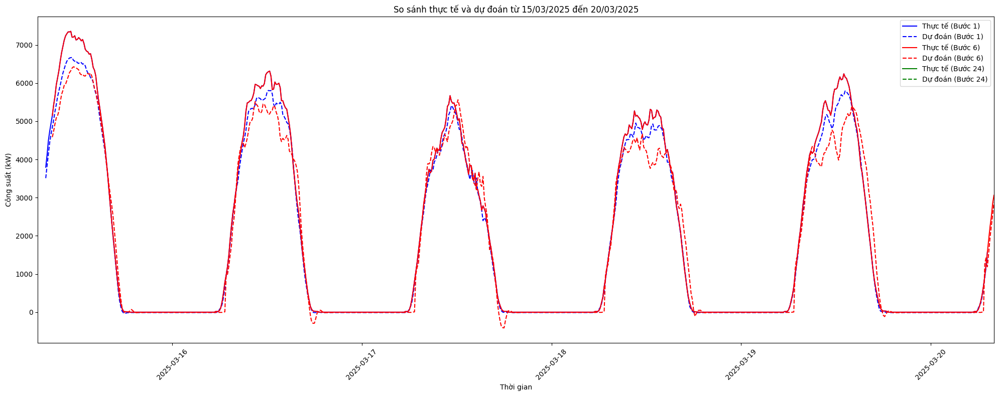

In [9]:
# %% Cell 7: Dự đoán và vẽ dữ liệu
def plot_predictions(model, scaler, start_date, end_date, channels=CHANNELS):
    power_df_plot, power_lookup_plot, scaler = query_power_data(start_date - TIME_STEP * SEQ_LENGTH, end_date + TIME_STEP * PRED_LENGTH)
    sequences_images_plot, sequences_times_plot = preprocess_images_from_folder(OUTPUT_DIR, start_date, end_date, channels)
    if sequences_images_plot.size == 0:
        print("⚠️ Không có dữ liệu ảnh để vẽ!")
        return
    
    dataset_plot, valid_sequences_times_plot, targets_normalized = prepare_dataset(sequences_images_plot, sequences_times_plot, power_lookup_plot, scaler)
    if not valid_sequences_times_plot:
        print("⚠️ Không có dữ liệu hợp lệ để vẽ!")
        return
    
    predictions_normalized = model.predict(dataset_plot)
    predictions = scaler.inverse_transform(predictions_normalized)
    true_values = scaler.inverse_transform(np.array(targets_normalized))
    
    full_times = [start_date + UTC_OFFSET + i * TIME_STEP for i in range(int((end_date - start_date).total_seconds() / 600) + PRED_LENGTH + 1)]
    
    full_true_step1 = np.full(len(full_times), np.nan)
    full_pred_step1 = np.full(len(full_times), np.nan)
    full_true_step6 = np.full(len(full_times), np.nan)
    full_pred_step6 = np.full(len(full_times), np.nan)
    full_true_step24 = np.full(len(full_times), np.nan)
    full_pred_step24 = np.full(len(full_times), np.nan)
    
    for i, t in enumerate(valid_sequences_times_plot):
        base_idx = int((t - (start_date + UTC_OFFSET)) / TIME_STEP)
        for j in range(PRED_LENGTH):
            idx = base_idx + j + 1
            if 0 <= idx < len(full_times):
                if j == 0:
                    full_true_step1[idx] = true_values[i, j]
                    full_pred_step1[idx] = predictions[i, j]
                elif j == 5:
                    full_true_step6[idx] = true_values[i, j]
                    full_pred_step6[idx] = predictions[i, j]
                elif j == 23:
                    full_true_step24[idx] = true_values[i, j]
                    full_pred_step24[idx] = predictions[i, j]
    
    plt.figure(figsize=(20, 8))
    plt.plot(full_times, full_true_step1, label='Thực tế (Bước 1)', color='blue')
    plt.plot(full_times, full_pred_step1, label='Dự đoán (Bước 1)', color='blue', linestyle='--')
    plt.plot(full_times, full_true_step6, label='Thực tế (Bước 6)', color='red')
    plt.plot(full_times, full_pred_step6, label='Dự đoán (Bước 6)', color='red', linestyle='--')
    plt.plot(full_times, full_true_step24, label='Thực tế (Bước 24)', color='green')
    plt.plot(full_times, full_pred_step24, label='Dự đoán (Bước 24)', color='green', linestyle='--')
    
    plt.xlabel('Thời gian')
    plt.ylabel('Công suất (kW)')
    plt.title(f'So sánh thực tế và dự đoán từ {start_date.strftime("%d/%m/%Y")} đến {end_date.strftime("%d/%m/%Y")}')
    plt.legend()
    plt.xticks(rotation=45)
    plt.xlim(start_date + UTC_OFFSET, end_date + UTC_OFFSET + TIME_STEP * PRED_LENGTH)
    plt.tight_layout()
    plt.show()

    return predictions, power_df_plot, full_times
predictions, power_df_plot, full_times = plot_predictions(model, scaler, PLOT_START, PLOT_END)

In [10]:
power_df_plot

,Time,P_uoc
0,2025-03-14 00:00:00,0.0
1,2025-03-14 00:10:00,0.0
2,2025-03-14 00:20:00,0.0
3,2025-03-14 00:30:00,0.0
4,2025-03-14 00:40:00,0.0
...,...,...
1003,2025-03-20 23:10:00,0.0
1004,2025-03-20 23:20:00,0.0
1005,2025-03-20 23:30:00,0.0
1006,2025-03-20 23:40:00,0.0


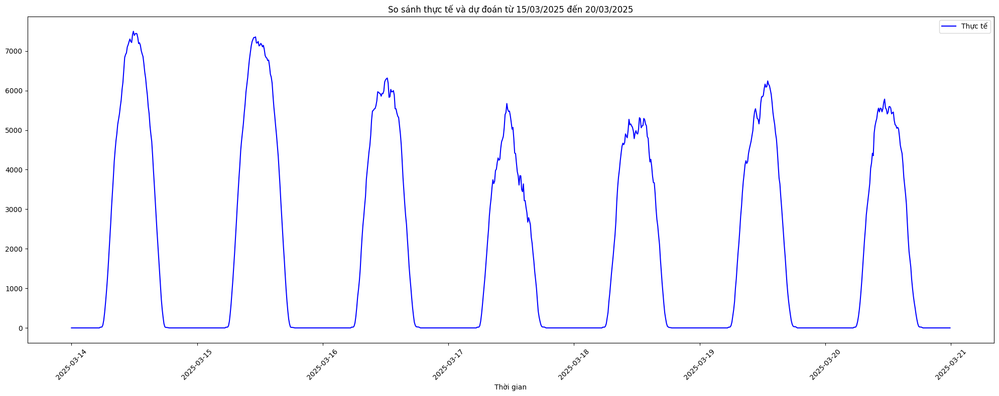

In [11]:
# Vẽ power_df_plot
plt.figure(figsize=(20, 8))
plt.plot(power_df_plot['Time'], power_df_plot['P_uoc'], label='Thực tế', color='blue')
# plt.plot(full_times, predictions.flatten(), label='Dự đoán', color='red', linestyle='--')
plt.xlabel('Thời gian')
# plt.ylabel('Công suất (kW)')
plt.title(f'So sánh thực tế và dự đoán từ {PLOT_START.strftime("%d/%m/%Y")} đến {PLOT_END.strftime("%d/%m/%Y")}')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
df_pred = pd.DataFrame(predictions, columns=[f"Step_{i+1}" for i in range(PRED_LENGTH)])
# Vẽ df_pred cột step 1 và step 24
plt.figure(figsize=(20, 8))
plt.plot(df_pred["Step_1"], label='Dự đoán (Bước 1)', color='blue')
# plt.plot(df_pred["Step_24"], label='Dự đoán (Bước 24)', color='green')
plt.xlabel('Thời gian')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 8))
plt.plot(df_pred["Step_24"], label='Dự đoán (Bước 24)', color='green')
plt.xlabel('Thời gian')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()